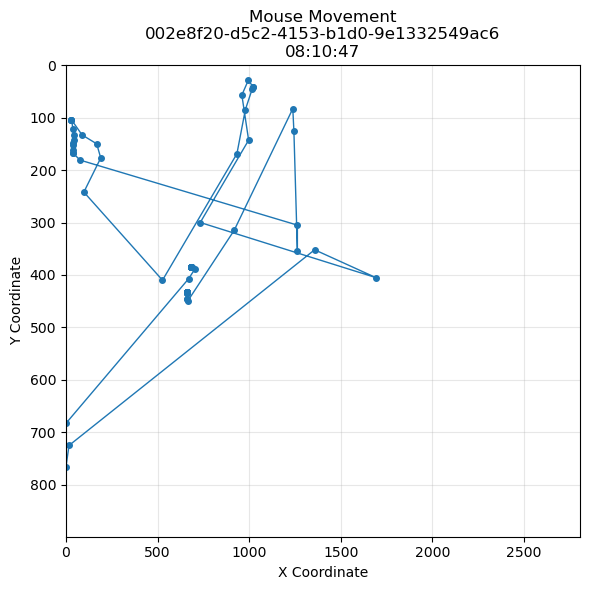

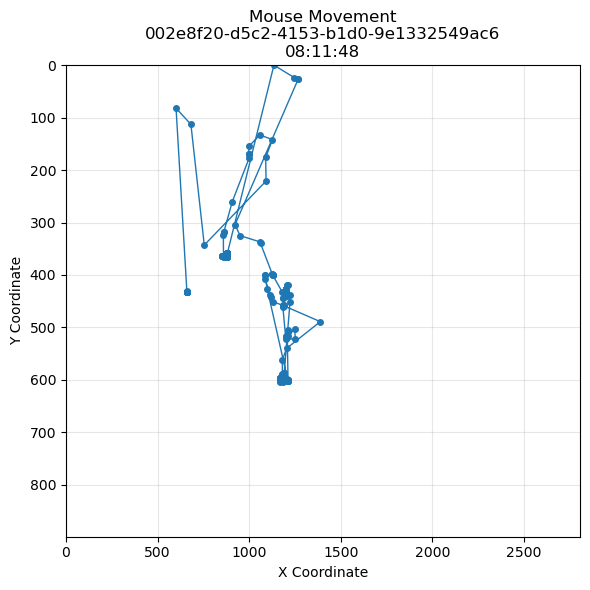

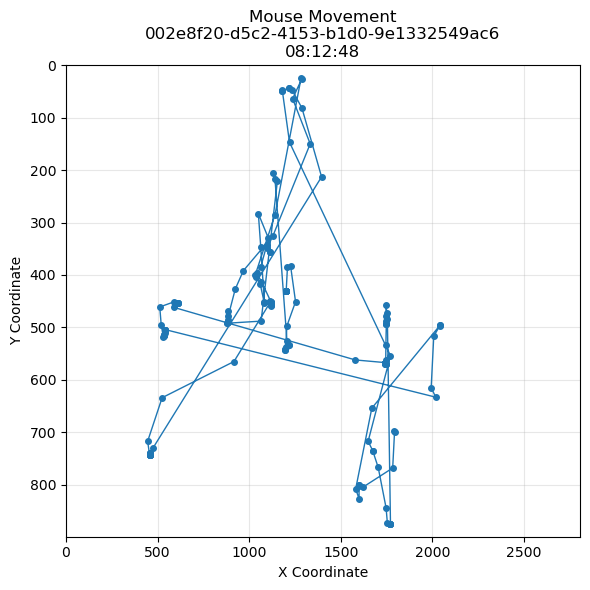

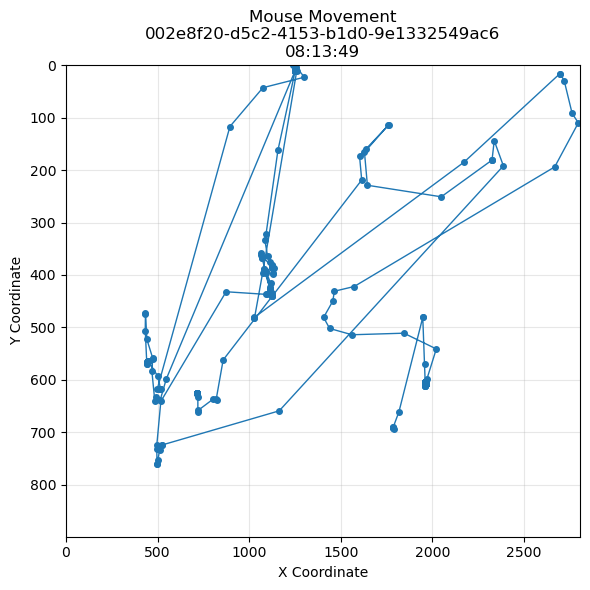

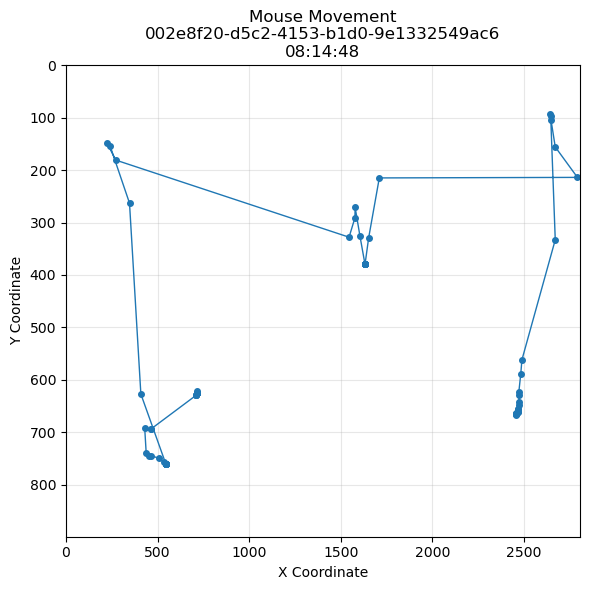

...

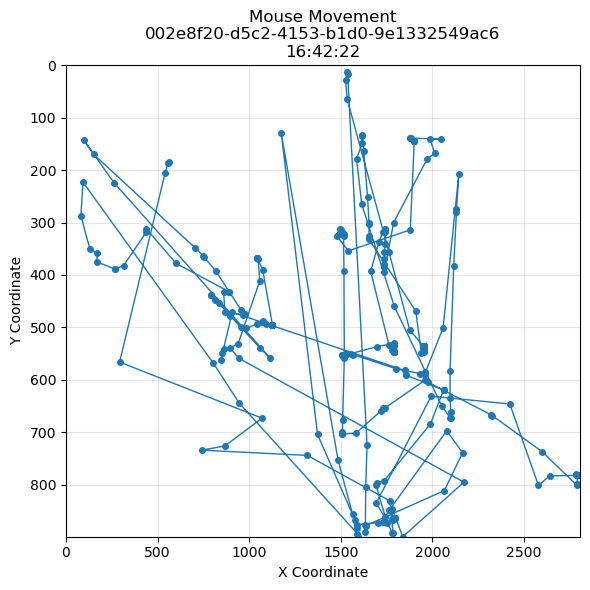

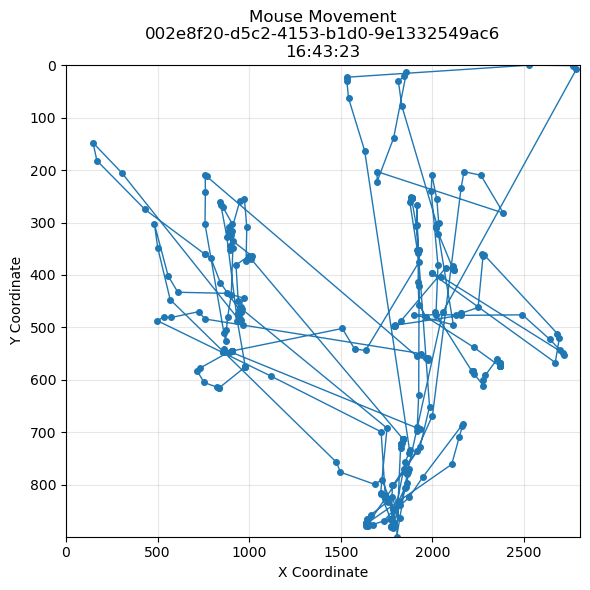

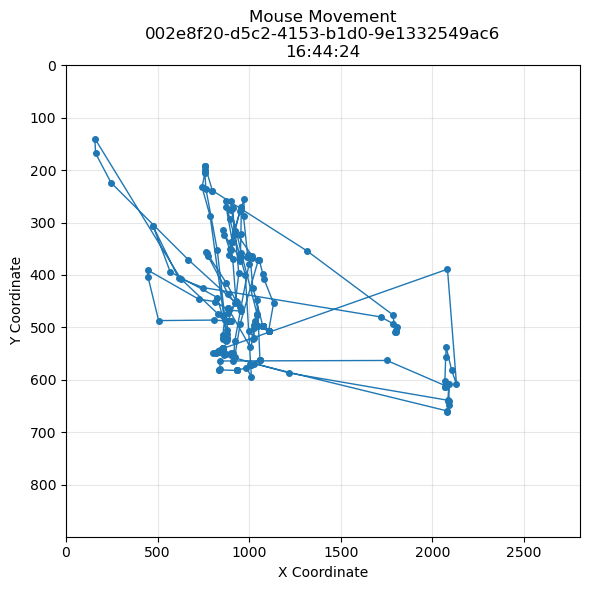

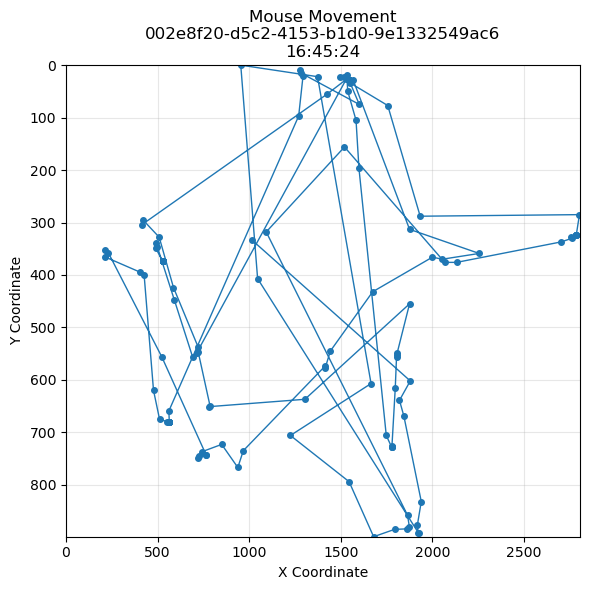

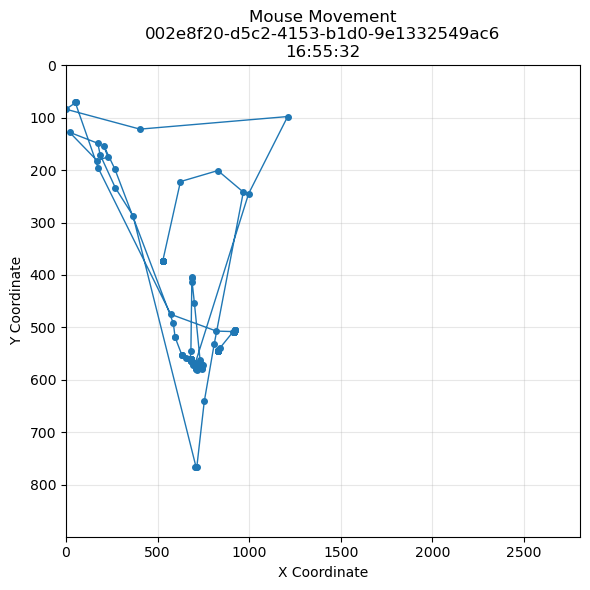

In [14]:
import pandas as pd
import ast
import matplotlib.pyplot as plt

# 1) Ayarlar
csv_path = r"C:\store\git\km-stat-activity\data\real\directional_bounding_box.csv"
target   = "002e8f20-d5c2-4153-b1d0-9e1332549ac6"   # buraya kendi GUID’ini koy

# 2) Veriyi oku ve filtrele
df = pd.read_csv(csv_path, dtype={'x': str, 'y': str})
df = df[df['profile_guid'] == target].sort_values('start_date_time').reset_index(drop=True)

# 3) String→liste dönüşümü
def parse_list(s):
    try:
        return ast.literal_eval(s)
    except:
        return []
df['x_list'] = df['x'].apply(parse_list)
df['y_list'] = df['y'].apply(parse_list)

# 4) Ortak ekran sınırlarını bul
all_x = [xi for lst in df['x_list'] for xi in lst]
all_y = [yi for lst in df['y_list'] for yi in lst]
xmin, xmax = min(all_x), max(all_x)
ymin, ymax = min(all_y), max(all_y)

# 5) Her dakikayı tek tek çiz
for idx, row in df.iterrows():
    x = row['x_list']
    y = row['y_list']
    t = row['start_date_time'].split(' ')[1]  # sadece HH:MM:SS
    
    # skip eğer veri yoksa
    if len(x) < 2 or len(y) < 2:
        continue
    
    plt.figure(figsize=(6,6))
    plt.plot(x, y, '-o', linewidth=1, markersize=4)
    plt.gca().invert_yaxis()
    plt.xlim(xmin, xmax)
    plt.ylim(ymax, ymin)
    plt.title(f"Mouse Movement\n{target}\n{t}")
    plt.xlabel("X Coordinate")
    plt.ylabel("Y Coordinate")
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()


In [16]:
!jupyter nbconvert --to html mouse_movement_clean_plot.ipynb --output-dir=analysis/scripts/mouse_movement



This application is used to convert notebook files (*.ipynb)
        to various other formats.


Options
The options below are convenience aliases to configurable class-options,
as listed in the "Equivalent to" description-line of the aliases.
To see all configurable class-options for some <cmd>, use:
    <cmd> --help-all

--debug
    set log level to logging.DEBUG (maximize logging output)
    Equivalent to: [--Application.log_level=10]
--show-config
    Show the application's configuration (human-readable format)
    Equivalent to: [--Application.show_config=True]
--show-config-json
    Show the application's configuration (json format)
    Equivalent to: [--Application.show_config_json=True]
--generate-config
    generate default config file
    Equivalent to: [--JupyterApp.generate_config=True]
-y
    Answer yes to any questions instead of prompting.
    Equivalent to: [--JupyterApp.answer_yes=True]
--execute
    Execute the notebook prior to export.
    Equivalent to: [--ExecutePr

[NbConvertApp] WARNING | pattern 'mouse_movement_clean_plot.ipynb' matched no files
[NbConvertApp] Making directory analysis/scripts/mouse_movement
